<a href="https://www.kaggle.com/code/marial2/data-analysis-of-crimes-in-baltimore?scriptVersionId=136705769" target="_blank"><img align="left" alt="Kaggle" title="Open in Kaggle" src="https://kaggle.com/static/images/open-in-kaggle.svg"></a>

In [1]:






# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/Crime-baltimore/Part_1_Crime_Data.csv


# Table of Contents
1. [Introduction](#Introduction)
2. [Data Loading and Data cleaning](#Data_preparation)
3. [Exploratory Data Analysis](#Exploratory-Data-Analysis)
    1. [Crime Over Time](#Crime-Over-Time)
    2. [Crime by District](#Crime-by-District)
    3. [Crime by Type](#Crime-by-Type)
    4. [Heatmap Analysis](#Heatmap-Analysis)
4. [Chi-Square Test of Independence](#Chi-Square-Test-of-Independence)
5. [Predictive Modeling](#Predictive-Modeling)
6. [Conclusion](#Conclusion)

In [2]:
#visual tools:
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from plotly.offline import init_notebook_mode, plot, iplot
import plotly as py
init_notebook_mode(connected=True) 
import plotly.graph_objs as go
import plotly.graph_objs as go
import plotly.tools as tls
#import missingno as msno
import pandas as pd

#import cufflinks as cf
import ydata_profiling
import folium
import datetime 

/opt/conda/lib/python3.10/site-packages/numba/core/decorators.py:262: NumbaDeprecationWarning:

numba.generated_jit is deprecated. Please see the documentation at: https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-generated-jit for more information and advice on a suitable replacement.

/opt/conda/lib/python3.10/site-packages/visions/backends/shared/nan_handling.py:51: NumbaDeprecationWarning:

The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.



In [3]:
def enable_plotly_in_cell():
  import IPython
  from plotly.offline import init_notebook_mode
  display(IPython.core.display.HTML('''<script src="/static/components/requirejs/require.js"></script>'''))
  init_notebook_mode(connected=False) 


#data set:
df_crime = pd.read_csv("/kaggle/input/Crime-baltimore/Part_1_Crime_Data.csv")

/tmp/ipykernel_20/1636894786.py:9: DtypeWarning:

Columns (12) have mixed types. Specify dtype option on import or set low_memory=False.



<a id="Introduction"></a>
# Introduction
In this Notebook I will analyse "Part1_Crime_Data.csv" dataset taken from https://data.baltimorecity.gov/:
This dataset represents the location and characteristics of major (Part 1) crime against persons such as homicide, shooting, robbery, aggravated assault etc. within the City of Baltimore. Data is updated weekly. 
This is an exploratory analysis.


The data was last updated May 17, 2023, the original csv file contains 565,726 records and 20 columns.

Attributes (columns) :
CCNO,
CrimeDateTime,
Location,
Description,
Inside_Outside,
Weapon,
Post,
Gender,
Age,
Race,
Ethnicity,
District,
Neighborhood,
Latitude,
Longitude,
Geolocation,
Premise,
Total_incidents,





<a id="Data_preparation"></a>
# Data Preparation - Data cleaning

He I'm checking the data types of the columns, handling missing values and handling time values.


In [4]:
len(df_crime.columns)

20

In [5]:
##code below was taken from -Exploratory Analysis of Vancouver Crime Data by KANGBO LU

def missing_value_describe(data):
    # check missing values in training data
    missing_value_stats = (data.isnull().sum() / len(data)*100)
    missing_value_col_count = sum(missing_value_stats > 0)
    missing_value_stats = missing_value_stats.sort_values(ascending=False)[:missing_value_col_count]
    print("Number of columns with missing values:", missing_value_col_count)
    if missing_value_col_count != 0:
        # print out column names with missing value percentage
        print("\nMissing percentage (desceding):")
        print(missing_value_stats)
    else:
        print("No missing data!!!")
missing_value_describe(df_crime)

Number of columns with missing values: 13

Missing percentage (desceding):
Ethnicity         95.199104
Weapon            76.887395
Age               20.184155
Premise           18.571681
Inside_Outside    18.510359
Gender            16.431729
Race               2.431395
Neighborhood       2.333929
Post               2.333071
District           2.295782
Location           0.495339
Longitude          0.146294
Latitude           0.146294
dtype: float64


We need to replace the null cells with the appropriate 

Missing percentages 

In [6]:
df_crime['Age'].describe()

count    836929.000000
mean         37.623839
std          39.259944
min       -7979.000000
25%          26.000000
50%          34.000000
75%          49.000000
max        8251.000000
Name: Age, dtype: float64

In [7]:
#replace the null values
# As HOUR is a float data type, I'm filling with a dummy value of '99'. For others, filling with 'N/A'


df_crime['Inside_Outside'].fillna('N/A', inplace = True)
df_crime['Weapon'].fillna('N/A', inplace = True)
df_crime['Ethnicity'].fillna('N/A', inplace = True)
df_crime['Premise'].fillna('N/A', inplace = True)
df_crime['Age'].fillna(37, inplace = True)
df_crime['Post'].fillna('N/A', inplace = True)
df_crime['Neighborhood'].fillna('N/A', inplace = True)
df_crime['District'].fillna('N/A', inplace = True)
df_crime['Race'].fillna('N/A', inplace = True)
df_crime['Location'].fillna('N/A', inplace = True)
df_crime['Longitude'].fillna(99, inplace = True)
df_crime['Latitude'].fillna(99, inplace = True)
df_crime['Gender'].fillna('N/A', inplace = True)

In the table below we see that six columns have more than 15% missing data.
All the missing cells are replaced by N/A, except for age, age is replaced by the average - 37 years old. Seven columns 
also have missing data, and they are also filled with N/A except for Longitude and Latitude, which are replaced with 99.
These values are only place holders, when we will go into the analysis of specific columns I will drop the rows.

|column          | Missing \%     | 
| -------------  |:--------------: |
| Ethnicity      | 95.199104      | 
| Weapon         | 76.887395      |  
| Age            | 20.184155      |
| Premise        | 18.571681      |
| Inside_Outside | 18.510359      |
| Gender         | 16.431729      |

In [8]:
#check to see how far the data goes starting from 1949 and see if there no dummy values
df_crime[df_crime['CrimeDateTime'] < '1950-01-01']

,RowID,CCNO,CrimeDateTime,CrimeCode,Location,Description,Inside_Outside,Weapon,Post,Gender,Age,Race,Ethnicity,District,Neighborhood,Latitude,Longitude,GeoLocation,Premise,Total_Incidents
561102,561103,22F07001,1922/06/22 13:00:00+00,4E,1100 LIGHT ST,COMMON ASSAULT,Inside,PERSONAL_WEAPONS,942,M,58.0,WHITE,N/A,SOUTHERN,FEDERAL HILL,39.276665,-76.612498,"(39.276665339513634,-76.612498181354084)",STREET,1
561103,561104,22F05949,1920/06/18 01:30:00+00,3AO,3700 LEVERTON AVE,ROBBERY,Inside,PERSONAL_WEAPONS,223,M,20.0,WHITE,HISPANIC_OR_LATINO,SOUTHEAST,BALTIMORE HIGHLANDS,39.291959,-76.566719,"(39.291958801122256,-76.56671900138528)",STREET,1
561104,561105,22E07562,1202/05/22 10:56:02+00,6J,900 BETHUNE RD,LARCENY,Inside,N/A,922,F,57.0,N/A,N/A,SOUTHERN,CHERRY HILL,39.244534,-76.623777,"(39.244533570913454,-76.62377677736842)",STREET,1
561105,561106,23C04992,1023/03/16 12:57:02+00,4B,4600 PEN LUCY RD,AGG. ASSAULT,N/A,PERSONAL_WEAPONS,822,F,30.0,BLACK_OR_AFRICAN_AMERICAN,NOT_HISPANIC_OR_LATINO,SOUTHWEST,TREMONT,39.285279,-76.694307,"(39.285279270908646,-76.694307321971934)",N/A,1
561106,561107,23A07816,1023/01/26 07:36:02+00,4E,3800 FALLSTAFF RD,COMMON ASSAULT,N/A,PERSONAL_WEAPONS,631,M,12.0,BLACK_OR_AFRICAN_AMERICAN,NOT_HISPANIC_OR_LATINO,NORTHWEST,FALLSTAFF,39.362747,-76.705049,"(39.362746693412298,-76.70504937200154)",N/A,1


Much of our analysis will be based on dates. The Baltimore website does not specify when they started to collect the crime data, problems may arise when comparing the changes in crime through the years, therefore we need to know if the data collection is consistant and if the years are complete (if we see data collected every month for every year for every category). Before starting the analysis we need to divide the data into years, months and hours, however,when I tried at first it gave me an error. I decided to first check the records before 1950, I quickly realized that some dates were in wrong format. These records were droped.


The results from checking the records show that some values in CrimDateTime are not in the right format and also shows that there are only two records with dates before 1950. All these records need to be deleted.

In [9]:

#delete all these dummy values and outlier dates
df_crime= df_crime.drop(df_crime[df_crime['CrimeDateTime'] < '1950-01-01'].index)

To analyse the data per year,months and hours I created new columns, before creating the new columns the data type of CrimeDateTime needs to be changed.

In [10]:
###Transform to date type so we can create new columns
df_crime["CrimeDateTime"] = df_crime["CrimeDateTime"].astype("datetime64")

In [11]:
#create new columns for year, month, day, hour, and minutes so we can perform some analyses
df_crime['year'] = pd.to_datetime(df_crime["CrimeDateTime"]).dt.year
df_crime['month'] = pd.to_datetime(df_crime["CrimeDateTime"]).dt.month
df_crime['day'] = pd.to_datetime(df_crime["CrimeDateTime"]).dt.day
df_crime['hour'] = pd.to_datetime(df_crime["CrimeDateTime"]).dt.hour
df_crime['minute'] = pd.to_datetime(df_crime["CrimeDateTime"]).dt.minute

Here below we run records group by year, this will indicate us what years need to be droped ( based on the idea that we have around half a million records, therefore we need thousands of records per year and we need consistant numbers

In [12]:
df_crime.groupby(["year"]).size().reset_index(name='counts')

,year,counts
0,1963,1
1,1966,1
2,1969,1
3,1970,1
4,1973,1
5,1975,1
6,1976,1
7,1977,1
8,1978,3
9,1979,1


We can now delete all records before 2011.

In [13]:


df_crime= df_crime.drop(df_crime[df_crime['CrimeDateTime'] < '2011-01-01'].index)

Our data we need complete years, we need to eliminate years that are incomplete. Here I aggregate the number of months per year to see if every year starting from 2011 has 12 months, if a year does not have 12 months it will be dropped. Here I found out that year 2023 only has 6 months, I kept the 2023 data in case I need to analyse further.

In [14]:
df12=df_crime.groupby(["year"]).agg({'month': 'nunique'})

df12[df12["month"]<12]

,month
year,
2023,6


In [15]:
df_crime2013= df_crime[df_crime['CrimeDateTime'] >= '2023-01-01']
df_crime2013

,RowID,CCNO,CrimeDateTime,CrimeCode,Location,Description,Inside_Outside,Weapon,Post,Gender,...,Latitude,Longitude,GeoLocation,Premise,Total_Incidents,year,month,day,hour,minute
0,1,23E09497,2023-05-27 01:30:00,4C,1000 STAMFORD RD,AGG. ASSAULT,N/A,PERSONAL_WEAPONS,823,F,...,39.296912,-76.710928,"(39.296912208573708,-76.710927966910035)",N/A,1,2023,5,27,1,30
1,2,23E09500,2023-05-27 00:00:00,4E,1200 RAMBLEWOOD RD,COMMON ASSAULT,N/A,PERSONAL_WEAPONS,414,M,...,39.362608,-76.592770,"(39.362607845286711,-76.592769535987117)",N/A,1,2023,5,27,0,0
2,3,23E10022,2023-05-27 12:00:00,6F,2200 LAKE AVE,LARCENY,N/A,N/A,431,M,...,39.328443,-76.579405,"(39.328442653265249,-76.579404511819575)",N/A,1,2023,5,27,12,0
3,4,23E10735,2023-05-27 09:00:00,6D,7200 PARK HEIGHTS AVE,LARCENY FROM AUTO,N/A,N/A,631,F,...,39.369023,-76.707272,"(39.36902326349631,-76.707272209871221)",N/A,1,2023,5,27,9,0
4,5,23E09625,2023-05-27 13:00:39,4E,1800 SAINT PAUL ST,COMMON ASSAULT,N/A,PERSONAL_WEAPONS,134,F,...,39.309962,-76.615071,"(39.309962233130491,-76.615071069308186)",N/A,1,2023,5,27,13,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
587748,587749,23C03541,2023-03-11 22:00:00,6F,700 VINE ST,LARCENY,N/A,N/A,122,F,...,39.290741,-76.629237,"(39.290741267888563,-76.629236698975888)",N/A,1,2023,3,11,22,0
587749,587750,23C04661,2023-03-11 00:00:00,6J,6200 HOLABIRD AVE,LARCENY,N/A,N/A,234,N/A,...,39.272323,-76.541276,"(39.272323444152136,-76.541276211987665)",N/A,1,2023,3,11,0,0
587750,587751,23C03461,2023-03-11 17:01:31,9S,3300 BRIGHTON ST,SHOOTING,Outside,FIREARM,813,Male,...,39.305137,-76.672245,"(39.3051369727369,-76.6722445283228)",STREET,1,2023,3,11,17,1
587751,587752,23C03461,2023-03-11 17:01:31,9S,3300 BRIGHTON ST,SHOOTING,Outside,FIREARM,813,Male,...,39.305137,-76.672245,"(39.3051369727369,-76.6722445283228)",STREET,1,2023,3,11,17,1


In [16]:
##drop 2013 data from the main analysis
df_crime= df_crime.drop(df_crime[df_crime['CrimeDateTime'] >= '2023-01-01'].index)

We also need to check if every year contains every type of crime - we assume here that normally every type of crime needs to be reported every year.
Below I loop into the years and type of crimes to see which type of crime from which year is missing. I find that in 2011 there are no shootings and no homicide reported. I therefore drop that year.

In [17]:
###We also need to make sure that each type of crime has values, 
r=df_crime.groupby(["year","Description"]).size().reset_index(name='counts')
Ds=df_crime['Description'].unique()
years=df_crime['year'].unique()
for i in range(len(years)):
    rs= r.loc[r['year'] ==years[i]]
    for j in range(len(Ds)):
        if Ds[j] not in list(rs['Description']):
            print(years[i])
            print(Ds[j])
            
###below we can see that shooting and Homicide has no values for 2011, so 2011 must be removed from 
##our dataframe

2011
HOMICIDE
2011
SHOOTING


In [18]:
df_crime= df_crime.drop(df_crime[df_crime['CrimeDateTime'] < '2012-01-01'].index)

<a id="Exploratory-Data-Analysis"></a>
# Exploratory Data Analysis

 This section involved exploring the data to gain insights. The analysis includes crimes per type, crime over time,



In [19]:
#dimension of the dataset
print("the dimension:", df_crime.shape)

the dimension: (966194, 25)


In [20]:
##quick picture of the number of crimes per type
df_crime['Description'].value_counts()

LARCENY                 214859
COMMON ASSAULT          173886
BURGLARY                131727
LARCENY FROM AUTO       123617
AGG. ASSAULT            111463
AUTO THEFT               82859
ROBBERY                  79203
SHOOTING                 12017
ROBBERY - COMMERCIAL     10667
ROBBERY - CARJACKING      8877
HOMICIDE                  6496
RAPE                      6374
ARSON                     4149
Name: Description, dtype: int64

Text(0, 0.5, 'crime count')

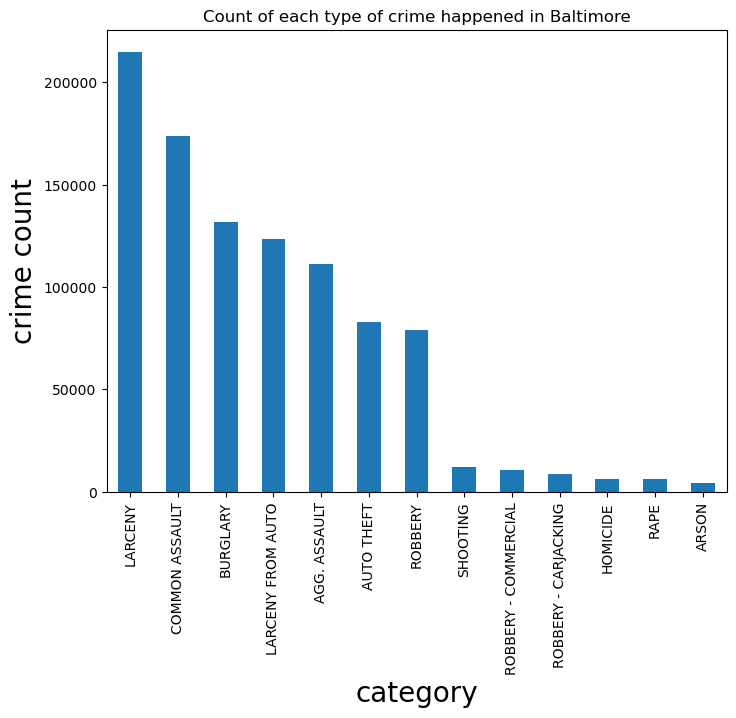

In [21]:
# crime type distribution in a bar chart
##all years combined , larceny, common assault and bulgary
nameplot = df_crime['Description'].value_counts().plot.bar(title='Count of each type of crime happened in Baltimore', figsize=(8,6))
nameplot.set_xlabel('category',size=20)
nameplot.set_ylabel('crime count',size=20)

The top 3 crimes per type are Larceny, Common Assualt and Bulgary. The 3 type of crimes that appeared the least are homicide, rape and arson. Larceny appears more than 200k, while arson appears only 4149 times which means that Larceny rates are 193% higher than arson.



<a id="Crime-Over-Time"></a>
# Crime Over Time

Text(38.0, 0.5, 'crime count')

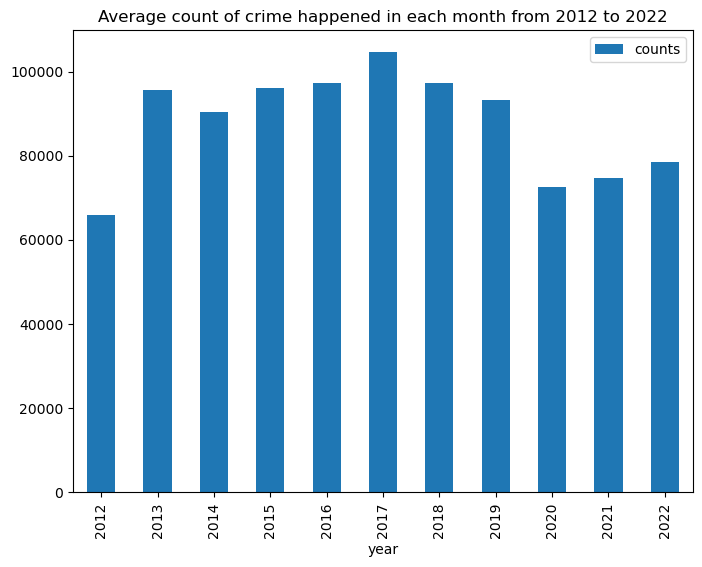

In [22]:
#quick overview of how many crimes per year
##2012 has least number of 

average_crime_count_by_month = df_crime.groupby(["year"]).size().reset_index(name='counts').groupby(["year"]).mean().round()
average_crime_count_by_month.reset_index().plot.bar(title='Average count of crime happened in each month from 2012 to 2022', 
                                                    x = "year", y = "counts",
                                                    figsize=(8,6))
nameplot.set_xlabel('year',size=20)
nameplot.set_ylabel('crime count',size=20)

In [23]:
counts_year= df_crime.groupby(["year"]).size().reset_index(name='counts').groupby(["year"]).mean().round()

In [24]:
count_year_prior= counts_year['counts'].shift()
(counts_year['counts']-count_year_prior)/count_year_prior*100

year
2012          NaN
2013    44.871503
2014    -5.329147
2015     6.283579
2016     1.256475
2017     7.444273
2018    -7.071905
2019    -4.106996
2020   -22.144022
2021     3.015103
2022     4.887902
Name: counts, dtype: float64

We note from the results that the year 2017 has the highest crime average while the year 2012 has the lowest. We also note that there are two jumps between years for average crime, the first is an increase by 45% from 2012 to 2013, while there is a decrease of 22% from 2019 to 2020. 

We can speculate that the data collection in 2012 was maybe incomplete, while the decrease of 22% might be explained by the pandemic.

Now I will create an empty dataframe containing all the crimes per year


In [25]:
#has crime decreased over the years in Baltimore

"""
Create empty dataframe to store the crime count over the years in Baltimore
"""
# year values
year_labels = sorted(df_crime["year"].unique())

# crime types
crime_types = sorted(df_crime['Description'].unique().tolist())

# Create the pandas DataFrame 
crime_count_by_year = pd.DataFrame(columns =["year"]) 
crime_count_by_year["year"] = year_labels
crime_count_by_year

,year
0,2012
1,2013
2,2014
3,2015
4,2016
5,2017
6,2018
7,2019
8,2020
9,2021


In [26]:
# gather yearly count of crime in Baltimore
for current_type in crime_types:
    print(current_type)
    current_crime = df_crime[df_crime["Description"]==current_type]
    current_crime_counts = current_crime["year"].value_counts(sort=False)
    #print(current_crime_counts)
    
    current_crime_index = current_crime_counts.index.tolist()

   
        
    
        
    current_crime_index, current_crime_counts = zip(*sorted(zip(current_crime_index, current_crime_counts)))

 
    crime_count_by_year[current_type] = current_crime_counts
crime_count_by_year

AGG. ASSAULT
ARSON
AUTO THEFT
BURGLARY
COMMON ASSAULT
HOMICIDE
LARCENY
LARCENY FROM AUTO
RAPE
ROBBERY
ROBBERY - CARJACKING
ROBBERY - COMMERCIAL
SHOOTING


,year,AGG. ASSAULT,ARSON,AUTO THEFT,BURGLARY,COMMON ASSAULT,HOMICIDE,LARCENY,LARCENY FROM AUTO,RAPE,ROBBERY,ROBBERY - CARJACKING,ROBBERY - COMMERCIAL,SHOOTING
0,2012,6547,317,4911,10946,12497,295,14792,9526,426,5016,256,387,39
1,2013,9094,538,7527,14754,16705,463,24338,13384,546,7412,242,461,86
2,2014,8518,432,7298,13734,14906,422,22674,13432,494,6474,310,1026,738
3,2015,9480,584,9124,15654,13968,684,21280,14094,572,7532,568,1338,1264
4,2016,10262,534,9202,14740,14994,636,20832,13030,590,9048,826,1328,1328
5,2017,11728,532,9328,16164,17638,684,21608,12372,761,9758,1148,1470,1406
6,2018,11262,254,8436,12436,16896,618,21422,12754,732,8808,966,1262,1354
7,2019,11470,230,7538,10854,16830,696,21546,11556,634,8118,1168,1036,1532
8,2020,10692,212,6014,8112,14994,670,15348,7324,584,5430,1036,710,1442
9,2021,11082,278,6370,6904,16458,668,14439,9161,582,5880,1158,324,1452


In [27]:
# Create traces
fig = go.Figure()
for current_crime in crime_types:
    current_type_count = crime_count_by_year[current_crime]
    fig.add_trace(
        go.Scatter(
            x=year_labels, 
            y=current_type_count,
            mode='lines+markers',
            name=current_crime
        )
    )
# Edit the layout
fig.update_layout(title='Crimes Over the Years in Baltimoe by Type',
                    xaxis_title='Year',
                    yaxis_title='Absolute Change',
                    autosize=True,
                    height=570
                 )

fig.update_layout(legend_orientation="h")

fig.show()

The graph Crimes in Baltimore by Type showcase the magnitude of type of crimes over the years, we note that carjacking,commercial robbery, rape, arson and shooting are around the same magnitude and seem to follow the same trend. On the other hand, autoteft and robbery also seem to follow the same trend. Larceny, has decreased since 2013 while Burglary has decreased since 2016.

In [28]:
from plotly.subplots import make_subplots

fig = make_subplots(
    rows=7, cols=2,
    subplot_titles=[str(i+1) + ". " + crime_types[i] for i in range(len(crime_types))]
)

In [29]:
# function to update row and col for adding subplots
current_row = 1
current_col = 1
def update_row_col(current_row, current_col):
    if current_col < 2:
        current_col += 1
    else:
        current_col = 1
        current_row += 1
    return current_row, current_col


In [30]:
years=sorted(df_crime["year"].unique())

# add trace to the subplot
#fig = go.Figure()
current_count = 1
for current_crime in crime_types:
    current_type_count = crime_count_by_year[current_crime]
    fig.add_trace(
        go.Scatter(
            x=year_labels, 
            y=current_type_count,
            mode='lines+markers',
            name=current_crime
        ),
        row=current_row, col=current_col
        
    )
   
    current_row, current_col = update_row_col(current_row, current_col)

fig.update_layout(
    height=1500, 
    width=900,
    title_text="Crimes in Baltimore Over the Years"
)

fig.update_layout(legend_orientation="h")
fig.show()

If we look at the type of crime over the years individually we can see that carjacking increased in 2013. Shooting increased sharply from 2012 to 2015, then from 2015 it steadily goes up. Robbery and rape both reached a peak in 2017. Just like we noticed in the lacercy clearly sees a decline since 2013 and burglary has decreased since 2017 going down. Larceny and Larceny from auto both show a downward trend. 
Aggregated assault and homicide also seems to follow the same upward trend we noticed in the aggregated graph.



.

We started our analysis in 2012, however, I suspect that year 2012 might be incomplete. In the next analysis I'm taking the first year as baseline, because I don't want to risk a bias, I am removing 2012 and keeping 2013 as the baseline. We will be able to see how much a type of crime in given year has increased % wise since 2013.

In [31]:
baseline_year = crime_count_by_year.iloc[1,1:]#taking year 2013 here
crime_count_by_year_percent_change = 100 * round((crime_count_by_year.iloc[1:,1:] - baseline_year) / baseline_year, 2)
crime_count_by_year_percent_change["year"] = year_labels[1:]
crime_count_by_year_percent_change

,AGG. ASSAULT,ARSON,AUTO THEFT,BURGLARY,COMMON ASSAULT,HOMICIDE,LARCENY,LARCENY FROM AUTO,RAPE,ROBBERY,ROBBERY - CARJACKING,ROBBERY - COMMERCIAL,SHOOTING,year
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2013
2,-6.0,-20.0,-3.0,-7.0,-11.0,-9.0,-7.0,0.0,-10.0,-13.0,28.0,123.0,758.0,2014
3,4.0,9.0,21.0,6.0,-16.0,48.0,-13.0,5.0,5.0,2.0,135.0,190.0,1370.0,2015
4,13.0,-1.0,22.0,-0.0,-10.0,37.0,-14.0,-3.0,8.0,22.0,241.0,188.0,1444.0,2016
5,29.0,-1.0,24.0,10.0,6.0,48.0,-11.0,-8.0,39.0,32.0,374.0,219.0,1535.0,2017
6,24.0,-53.0,12.0,-16.0,1.0,33.0,-12.0,-5.0,34.0,19.0,299.0,174.0,1474.0,2018
7,26.0,-57.0,0.0,-26.0,1.0,50.0,-11.0,-14.0,16.0,10.0,383.0,125.0,1681.0,2019
8,18.0,-61.0,-20.0,-45.0,-10.0,45.0,-37.0,-45.0,7.0,-27.0,328.0,54.0,1577.0,2020
9,22.0,-48.0,-15.0,-53.0,-1.0,44.0,-41.0,-32.0,7.0,-21.0,379.0,-30.0,1588.0,2021
10,25.0,-56.0,-6.0,-50.0,8.0,43.0,-32.0,-48.0,-17.0,-23.0,395.0,187.0,1500.0,2022


The results above clearly show that Larceny, Larceny auto and Arson have declining from 2013. Shooting has skyrocket if we compared to 2013, while ROBBERY - CARJACKING has also increased.

In [32]:
fig = make_subplots(
    rows=6, cols=2,
    subplot_titles=[str(i) for i in year_labels]
)


In [33]:
# function to update row and col for adding subplots
current_row = 1
current_col = 1
def update_row_col(current_row, current_col):
    if current_col < 2:
        current_col += 1
    else:
        current_col = 1
        current_row += 1
    return current_row, current_col

In [34]:
#df_crime['Description'].value_counts()



years=sorted(df_crime["year"].unique())

#df_crime[df_crime['year']==years[1]]

    

# add trace to the subplot
current_count = 1
for i in range(len(years)):
    a= df_crime[df_crime['year']==years[i]]
    b=a.groupby(["Description"]).size().reset_index(name='counts')
    y_counts=b['counts']
    x_des=b['Description']
    fig.add_trace(
        go.Bar(
            y=x_des, 
            x=y_counts,
             orientation='h',
            name=str(years[i])
        
           
        ),
        row=current_row, col=current_col,  
    )
    current_row, current_col = update_row_col(current_row, current_col)

fig.update_layout(
    height=1500, 
    width=900,
    title_text="Crimes in Baltimore Over the Years",
    
)

fig.update_layout(legend_orientation="h")
fig.show()

In [35]:
fig = go.Figure()



    
for i in range(len(years)):
    a= df_crime[df_crime['year']==years[i]]
    b=a.groupby(["Description"]).size().reset_index(name='counts')
    bs=b['counts']
    fig.add_trace(
        go.Bar(
            x=bs, 
            y=b['Description'],
            orientation='h',
            name=str(years[i])
        )
    )
# Edit the layout
fig.update_layout(title='Crimes Over the Years in Baltimoe by Type',
                    xaxis_title='Year',
                    yaxis_title='Absolute Change',
                    autosize=True,
                    height=800
                 )

fig.update_layout(legend_orientation="h")

fig.show()

The 2 previous bar chart (individual and aggregate) analysis show us that 2022 compared to other years has two of highest numbers of most violent crimes (common assault, aggregate assault). 2013 is interesting because we can see how the other type of crimes are lower compared to other years except for Larceny which is the highest for that year.

In [36]:

# Group the data by year and hour, and count the number of crimes for each group
crime_by_hour_year = df_crime.groupby(['hour', 'year']).size().reset_index(name='counts')

# For each year, find the hour with the maximum count of crimes
crime_by_hour_year_max = crime_by_hour_year.groupby('year')['counts'].idxmax()
crime_peak_hour_year = crime_by_hour_year.loc[crime_by_hour_year_max]

# Display the result
crime_peak_hour_year

,hour,year,counts
198,18,2012,4071
166,15,2013,5836
167,15,2014,5516
201,18,2015,5870
202,18,2016,5962
5,0,2017,6667
204,18,2018,5768
7,0,2019,5468
8,0,2020,4498
9,0,2021,4289


The table above shows the time when the highest number of crimes happen per year. I notice here that between 2012 and 2016 the highest number of crimes happened between 15h and 18h, year 2018 and year 2022 highest number are respectively 18h and 17h. On the other hand, the highest number of crimes in 2018, and 2019 to 2021 happened at midnight. I can conclude here that there is no real pattern except for the fact that the highest number of crimes do not happen in the middle of the night or in the morning.

<a id="crime-by-district"></a>
# Crime by District

Text(38.0, 0.5, 'count')

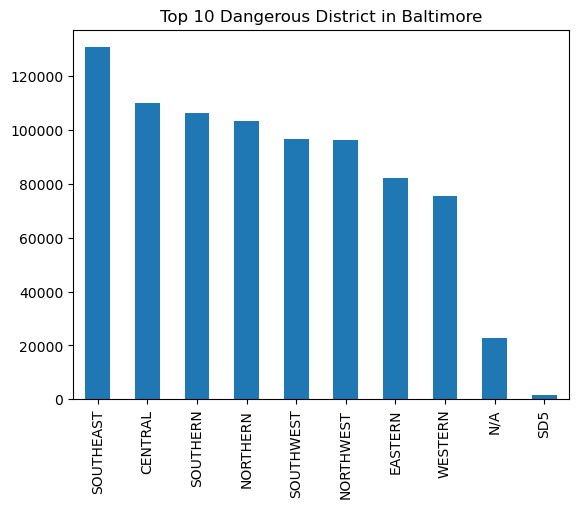

In [37]:
df_crime["District"].value_counts()[1:11].plot.bar(
    title='Top 10 Dangerous District in Baltimore')
nameplot.set_xlabel('block name',size=20)
nameplot.set_ylabel('count',size=20)

Text(38.0, 0.5, 'count')

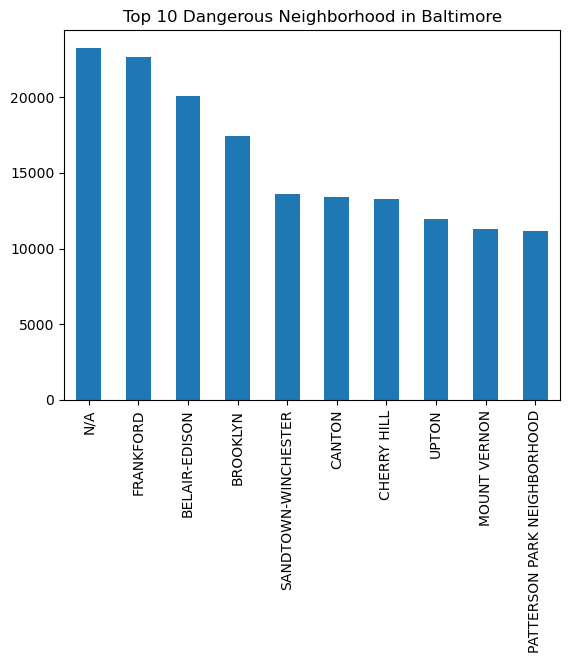

In [38]:
df_crime["Neighborhood"].value_counts()[1:11].plot.bar(
    title='Top 10 Dangerous Neighborhood in Baltimore')
nameplot.set_xlabel('block name',size=20)
nameplot.set_ylabel('count',size=20)


In the above results we see that the value that appears the most in the most dangerous neighbourhood is N/A, this even though only 2% of the missing values in the column. The second value that is the neighborhood of Frankford. This makes sense since Frankford,according to Wikipedia, is the most populous of the city's designated neighborhoods, with over 17,000 residents. Frankford is a neighborhood in northeast Baltimore. According to our results, the NorthEast district is the 4th most dangerous district, therefore, the only reason why Frankford is has the highest number of crimes is because is densily populated and not because it stands on a particularly dangerous district. In fact, the most dangerous district according to our data is southeastern district.

In [39]:
###95% of ethinicity is missing, while around 2% of race is missing
##this means that ethinicity was not filled in most of the time
##Also after analysing the data I noticed that ethnicity sometimes doesn't match the race 
##I will proceed to two different analysis, one condisering the ethnicity and race and the other, only the race

<a id="Heatmap-Analysis"></a>
# Heatmap Analysis

The data provides us with Latitude and longitude, with this, we can create a heatmap. Before creating the map however, we need to remove all the erreneous records. This includes 0's and the 99 values that we added to replace the NUll values.

In [40]:
import folium
from folium.plugins import HeatMap

# Remove rows with missing Latitude or Longitude
df_heatmap = df_crime.dropna(subset=['Latitude', 'Longitude'])
df_heatmap= df_heatmap.drop(df_heatmap[df_heatmap['Longitude']==99].index)
df_heatmap= df_heatmap.drop(df_heatmap[df_heatmap['Latitude']==99].index)



In [41]:
#checking if we have longitude and latitude as 0's
df_crime[df_crime['Longitude']==0]

,RowID,CCNO,CrimeDateTime,CrimeCode,Location,Description,Inside_Outside,Weapon,Post,Gender,...,Latitude,Longitude,GeoLocation,Premise,Total_Incidents,year,month,day,hour,minute
11410,11411,22L06729,2022-12-22 07:35:00,6D,LOMBARD ST & S EAST AV,LARCENY FROM AUTO,N/A,N/A,N/A,F,...,0.0,0.0,"(0,0)",N/A,1,2022,12,22,7,35
12252,12253,22L06435,2022-12-21 10:00:00,3AF,ST & COLVIN ST,ROBBERY,N/A,FIREARM,N/A,M,...,0.0,0.0,"(0,0)",N/A,1,2022,12,21,10,0
13952,13953,22L05426,2022-12-18 00:30:00,4E,ST & S WOLFE ST,COMMON ASSAULT,N/A,N/A,N/A,M,...,0.0,0.0,"(0,0)",N/A,1,2022,12,18,0,30
13962,13963,22L05426,2022-12-18 00:30:00,4E,ST & S WOLFE ST,COMMON ASSAULT,N/A,N/A,N/A,F,...,0.0,0.0,"(0,0)",N/A,1,2022,12,18,0,30
16697,16698,22L04124,2022-12-13 16:30:00,6G,900 ELLICOTT DY,LARCENY,N/A,N/A,N/A,M,...,0.0,0.0,"(0,0)",N/A,1,2022,12,13,16,30
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1048470,1048471,12H11824,2012-08-24 10:35:00,6F,800 W MADISON ST,LARCENY,O,N/A,N/A,M,...,0.0,0.0,"(0,0)",STREET,1,2012,8,24,10,35
1048502,1048503,12H02762,2012-08-06 08:00:00,6E,ST & EUTAW PL,LARCENY,O,N/A,N/A,M,...,0.0,0.0,"(0,0)",STREET,1,2012,8,6,8,0
1048527,1048528,12I02042,2012-09-04 15:00:00,5D,200 HAWTHORNE RD,BURGLARY,I,N/A,N/A,M,...,0.0,0.0,"(0,0)",GARAGE ON PRIV. PROP,1,2012,9,4,15,0
1048564,1048565,12H07745,2012-08-15 18:00:00,6E,6400 E PRATT ST,LARCENY,O,N/A,N/A,N/A,...,0.0,0.0,"(0,0)",PARKING LOT-OUTSIDE,1,2012,8,15,18,0


In [42]:
#we can see that some rows are filled with erroneaous information so we should remove them and run the heatmap 
#once again

df_heatmap= df_heatmap.drop(df_heatmap[df_heatmap['Latitude']==0.000000].index)
df_heatmap= df_heatmap.drop(df_heatmap[df_heatmap['Longitude']==0.000000].index)



In [43]:
# Create a map centered around Baltimore
m = folium.Map(location=[39.2904, -76.6122], zoom_start=12)

heat_map = df_heatmap[['Latitude','Longitude']].to_numpy()
#HeatMap(wv_mat).add_to(heat_m)


HeatMap(heat_map).add_to(m)

m

The heatmap does not provide any interesting information, what we notice is that the data is distributed evenly whithin Baltimore.

In [44]:
# Group the data by latitude and longitude and count the number of crimes for each group
crime_by_location = df_heatmap.groupby(['Latitude', 'Longitude']).size().reset_index(name='counts')

crime_by_location

,Latitude,Longitude,counts
0,39.200434,-76.553318,1
1,39.200741,-76.555502,50
2,39.200749,-76.555504,10
3,39.200820,-76.555785,4
4,39.201917,-76.556505,10
...,...,...,...
143325,39.371975,-76.590354,6
143326,39.371976,-76.589385,4
143327,39.371977,-76.589507,2
143328,39.371979,-76.564571,2


In [45]:
# Filter out placeholder coordinates
#crime_by_location = crime_by_location[(crime_by_location['Latitude'] != 0) & (crime_by_location['Longitude'] != 0)]

# Find the location with the maximum count of crimes
most_dense_location = crime_by_location.loc[crime_by_location['counts'].idxmax()]
most_dense_location

Latitude       39.318685
Longitude     -76.654398
counts       1582.000000
Name: 89085, dtype: float64

In [46]:
lat_range = (most_dense_location['Latitude'] - 0.01, most_dense_location['Latitude'] + 0.01)
print(lat_range)
lon_range = (most_dense_location['Longitude'] - 0.01, most_dense_location['Longitude'] + 0.01)
lon_range

(39.30868504, 39.328685039999996)


(-76.66439769, -76.64439768999999)

In [47]:
# Define a small range around the most dense location to consider as the 'zone'
lat_range = (most_dense_location['Latitude'] - 0.01, most_dense_location['Latitude'] + 0.01)
lon_range = (most_dense_location['Longitude'] - 0.01, most_dense_location['Longitude'] + 0.01)

# Filter the data for crimes that occurred in this zone
df_zone = df_crime[(df_crime['Latitude'].between(*lat_range)) & (df_crime['Longitude'].between(*lon_range))]

# Count the number of each type of crime in the zone
crime_counts = df_zone['Description'].value_counts()

# Get the top 3 types of crime
top_3_crimes = crime_counts.head(3)
top_3_crimes

LARCENY           5752
COMMON ASSAULT    4405
AGG. ASSAULT      3102
Name: Description, dtype: int64

From the above analysis we find that Larcency, common assault and Agg. Assault are the 3 most common crimes around the most dense crime location.

<a id="Predictive-Modeling"></a>
# Predictive Modeling: Linear Regression
Here below I'm taking a simple predictive model - a regression model per type of crime. For this, I need to convert the data into a pivot table. In this case I took year as the dependant value and #of crimes for a specific crime as the independant value. Because of the data way the data is presented I can't do a mutiple regression model. 


In [48]:
crime_by_year_type = df_crime.groupby(['year', 'Description']).size().reset_index(name='counts')

pivot_data = crime_by_year_type.pivot(index='year', columns='Description', values='counts').fillna(0)
pivot_data

Description,AGG. ASSAULT,ARSON,AUTO THEFT,BURGLARY,COMMON ASSAULT,HOMICIDE,LARCENY,LARCENY FROM AUTO,RAPE,ROBBERY,ROBBERY - CARJACKING,ROBBERY - COMMERCIAL,SHOOTING
year,,,,,,,,,,,,,
2012,6547,317,4911,10946,12497,295,14792,9526,426,5016,256,387,39
2013,9094,538,7527,14754,16705,463,24338,13384,546,7412,242,461,86
2014,8518,432,7298,13734,14906,422,22674,13432,494,6474,310,1026,738
2015,9480,584,9124,15654,13968,684,21280,14094,572,7532,568,1338,1264
2016,10262,534,9202,14740,14994,636,20832,13030,590,9048,826,1328,1328
2017,11728,532,9328,16164,17638,684,21608,12372,761,9758,1148,1470,1406
2018,11262,254,8436,12436,16896,618,21422,12754,732,8808,966,1262,1354
2019,11470,230,7538,10854,16830,696,21546,11556,634,8118,1168,1036,1532
2020,10692,212,6014,8112,14994,670,15348,7324,584,5430,1036,710,1442


In [49]:
from sklearn.linear_model import LinearRegression

# Group the data by year and description, and count the number of crimes for each group
crime_by_year_type = df_crime.groupby(['year', 'Description']).size().reset_index(name='counts')

# Pivot the data to have years as rows and crime types as columns
pivot_data = crime_by_year_type.pivot(index='year', columns='Description', values='counts').fillna(0)

# Create a linear regression model for each crime type
models = {}
for crime_type in pivot_data.columns:
    X = pivot_data.index.values.reshape(-1, 1)  # Features (years)
    y = pivot_data[crime_type].values  # Target (counts)
    model = LinearRegression().fit(X, y)
    models[crime_type] = model

# Predict the amount of each crime type for 2023
predictions = {crime_type: model.predict([[2023]])[0] for crime_type, model in models.items()}
predictions

{'AGG. ASSAULT': 12498.03636363626,
 'ARSON': 209.0181818181809,
 'AUTO THEFT': 7455.290909090909,
 'BURGLARY': 7734.0,
 'COMMON ASSAULT': 17685.109090909245,
 'HOMICIDE': 775.7272727272721,
 'LARCENY': 16722.89090909087,
 'LARCENY FROM AUTO': 8331.836363636306,
 'RAPE': 623.9090909090919,
 'ROBBERY': 6939.927272727276,
 'ROBBERY - CARJACKING': 1455.9272727272764,
 'ROBBERY - COMMERCIAL': 1107.4000000000015,
 'SHOOTING': 1900.9818181818118}

In [50]:

prediction= pd.DataFrame(predictions.items(), columns=['Date', 'count_prediction'])



In [51]:
crime_2013=df_crime2013.groupby(['year', 'Description']).size().reset_index(name='counts')

crime_2013['counts12']= crime_2013['counts']*2

crime_2013['prediction']= round(prediction['count_prediction'])

crime_2013['difference']=round((crime_2013['prediction']-crime_2013['counts12'])/crime_2013['counts12']*100)
crime_2013

,year,Description,counts,counts12,prediction,difference
0,2023,AGG. ASSAULT,3989,7978,12498.0,57.0
1,2023,ARSON,90,180,209.0,16.0
2,2023,AUTO THEFT,5436,10872,7455.0,-31.0
3,2023,BURGLARY,2215,4430,7734.0,75.0
4,2023,COMMON ASSAULT,7613,15226,17685.0,16.0
5,2023,HOMICIDE,220,440,776.0,76.0
6,2023,LARCENY,7073,14146,16723.0,18.0
7,2023,LARCENY FROM AUTO,2917,5834,8332.0,43.0
8,2023,RAPE,195,390,624.0,60.0
9,2023,ROBBERY,2288,4576,6940.0,52.0


The dataset contains 6 months of 2023 data while the prediction is for the full year of 2023. To compare both I simply divide the prediction by two and then calculate the difference between one and the other. The table above shows that the prediction is off.

<a id="Chi-Square-Test-of-Independence"></a>
# Chi-Square Test of Independence

Here below I'm trying to answer two different questions:
Does race have an impact on the type of crime?
Does Age and Gender has an impact on the type of crime?


Here I'm using chi2_contingency - the chi2 -contingency- is used when we don't know the underlying distribution but you want to test whether two (or more) groups have the same distribution. The null hypothesis is: two groups have no significant difference.

In [52]:
df_crime['Race'].unique()

array(['BLACK_OR_AFRICAN_AMERICAN', 'N/A', 'WHITE', 'ASIAN', 'UNKNOWN',
       'AMERICAN_INDIAN_OR_ALASKA_NATIVE',
       'NATIVE_HAWAIIAN_OR_OTHER_PACIFIC_ISLANDER'], dtype=object)

In [53]:
df_crime=df_crime.drop(df_crime[df_crime['Race']=='N/A'].index)
df_crime=df_crime.drop(df_crime[df_crime['Race']=='UNKNOWN'].index)

In [54]:
from scipy.stats import chi2_contingency

# Group the data by race and description, and count the number of crimes for each group
crime_by_race_type = df_crime.groupby(['Race', 'Description']).size().reset_index(name='counts')

# Pivot the data to have races as rows and crime types as columns
pivot_data = crime_by_race_type.pivot(index='Race', columns='Description', values='counts').fillna(0)

# Perform a chi-square test of independence
chi2, p, dof, expected = chi2_contingency(pivot_data)
chi2, p

(36567.05732968939, 0.0)

In [55]:
# Create age groups
bins = [0, 25, 45, np.inf]
AgeGroup = ['<25', '25-45', '45+']

# Add column using np.where()
def f(x):
    if (x < 25):
        return '<25'
    elif (25 <= x < 45):
        return '45+'
    elif (x>=45):
        return '25-45'
  




In [56]:
df_crime['AgeGroup'] = df_crime['Age'].apply(f)
df_crime

,RowID,CCNO,CrimeDateTime,CrimeCode,Location,Description,Inside_Outside,Weapon,Post,Gender,...,Longitude,GeoLocation,Premise,Total_Incidents,year,month,day,hour,minute,AgeGroup
8884,8885,22L08161,2022-12-27 19:50:00,4B,2800 BELMONT AVE,AGG. ASSAULT,N/A,BLUNT_OBJECT,813,F,...,-76.664290,"(39.303730960860783,-76.664290319043317)",N/A,1,2022,12,27,19,50,25-45
8885,8886,22L08175,2022-12-27 19:03:00,4E,5600 MAYVIEW AVE,COMMON ASSAULT,N/A,PERSONAL_WEAPONS,444,F,...,-76.540905,"(39.33497022709787,-76.540904710684231)",N/A,1,2022,12,27,19,3,45+
8886,8887,22L08176,2022-12-27 19:55:00,4B,1900 BAKER ST,AGG. ASSAULT,N/A,KNIFE_CUTTING_INSTRUMENT,735,M,...,-76.648047,"(39.306657091747518,-76.648047282032124)",N/A,1,2022,12,27,19,55,25-45
8887,8888,22L08177,2022-12-27 20:00:00,6F,2400 FREDERICK AVE,LARCENY,N/A,N/A,835,F,...,-76.653474,"(39.2830121543156,-76.653474054806679)",N/A,1,2022,12,27,20,0,45+
8888,8889,22L08182,2022-12-27 19:30:00,6D,4300 PARKTON ST,LARCENY FROM AUTO,N/A,N/A,833,F,...,-76.689648,"(39.277160265917701,-76.689647557462038)",N/A,1,2022,12,27,19,30,45+
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1048567,1048568,12H11776,2012-08-24 02:30:00,7A,1100 CLOVERDALE RD,AUTO THEFT,O,N/A,133,M,...,-76.640422,"(39.3151437216425,-76.6404218352825)",STREET,1,2012,8,24,2,30,25-45
1048568,1048569,12H13628,2012-08-24 12:00:00,6G,1500 S CLINTON ST,LARCENY,I,N/A,231,F,...,-76.569001,"(39.2752329468638,-76.5690013929861)",OTHER - INSIDE,1,2012,8,24,12,0,25-45
1048570,1048571,12H12047,2012-08-24 08:30:00,7A,1300 N KENWOOD AVE,AUTO THEFT,O,N/A,332,F,...,-76.578784,"(39.3063633600761,-76.5787843764457)",STREET,1,2012,8,24,8,30,<25
1048573,1048574,12H12854,2012-08-24 11:00:00,7A,2000 E FAYETTE ST,AUTO THEFT,O,N/A,321,M,...,-76.587822,"(39.2943354545083,-76.58782223439)",STREET,1,2012,8,24,11,0,<25


In [57]:
# Group the data by AgeGroup and description, and count the number of crimes for each group

crime_by_AgeGroup = df_crime.groupby(['AgeGroup', 'Description']).size().reset_index(name='counts')

# Pivot the data to have races as rows and crime types as columns
pivot_dataA = crime_by_AgeGroup.pivot(index='AgeGroup', columns='Description', values='counts').fillna(0)

# Perform a chi-square test of independence
chi2, p, dof, expected = chi2_contingency(pivot_dataA)
chi2, p

(61875.689900384226, 0.0)

In [58]:
df_crime=df_crime.drop(df_crime[df_crime['Gender']=='N/A'].index)

In [59]:

# Group the data by Gender and description, and count the number of crimes for each group

crime_by_Gender = df_crime.groupby(['Gender', 'Description']).size().reset_index(name='counts')

# Pivot the data to have races as rows and crime types as columns
pivot_dataG = crime_by_Gender.pivot(index='Gender', columns='Description', values='counts').fillna(0)

# Perform a chi-square test of independence
chi2, p, dof, expected = chi2_contingency(pivot_dataG)
chi2, p

(729994.1979187021, 0.0)

We reject the null hypothesis in the 3 cases, meaning that there is a difference in the outcome regarding age group , gender and race.

<a id="Conclusion"></a>
# Conclusion

Baltimore dataset contains data starting from the 1960's, however the entries don't seem consistent (only a few in a total of half a million). The Data becomes more consistent from year 2012, however data is incomplete for 2023 (since the year isn't finished). Therefore the analysis is from 2012 to 2013.


Baltimore crime data shows that specific types of crimes are more 'popular' regardless of the year, namely Larceny, Common Assault and Burglary. While others are less 'popular' regardless of the year, namely Homicide, Rape and Arson. Larceny and Larceny from auto both show a downward trend. Aggregated assault and homicide seem to follow the same upward trend. Robbery and rape both reached a peak in 2017. Shooting increased sharply from 2012 to 2015, then from 2015 it steadily goes up.

Frankford is the city with the highest crime level while the district with the highest level of crime is southeast. However, when we look at the heatmap, no particular city or district stands out. From the above analysis we find that Larcency, common assault and Agg. Assault are the 3 most common crimes around the most dense crime location (based on latitude and longitude).

When it comes to the average time when crimes where pertpetuated, we see that it varies depending on the year. The only pattern noticeable is that crimes tend to happen between the afternoon (from 15h) to midnight.

I performed a simple regression with the years as the dependent value and number of crimes per type of crime as the independant value. I then predicted the number of crimes for 2023 and compared the results with the 2023 data we had previously (by doubling the number of crimes for 2023). I concluded that the results are off, and that a deeper analysis should be done if we want to forecast the number of crimes (ex.: use of time series). 

I also checked if race, age or gender has an impact on the type of crime by performing a chi2_contigency test and concluded it does. Further analysis would need to be done to see what are exactly the differences.





